# **Data Preparation**

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import os
import pathlib
from matplotlib import pyplot as plt
import seaborn as sns
import pickle
import pandas as pd
import numpy as np
import cv2
import skimage
from skimage.util import random_noise
import tensorflow as tf

from tqdm.notebook import tqdm
import random

In [2]:
os.listdir()

['(Baseline)_REDNet_256x256.ipynb',
 '.ipynb_checkpoints',
 'i.png',
 'MWCNN_256x256.ipynb',
 'PRIDNet_256x256.ipynb',
 'test',
 'train',
 'train_GT']

In [3]:
root = pathlib.Path('C:/Users/Administrator/Desktop/Image-Denoising-using-Deep-Learning-main/Models/train/0042_002_IP_01600_03100_5500_N')
img_paths = list(root.rglob("*.PNG*"))
img_paths_lst = [str(path) for path in img_paths]
gt_lst = []
noisy_lst= []
for p in img_paths_lst:
    noisy_lst.append(p)
root = pathlib.Path('C:/Users/Administrator/Desktop/Image-Denoising-using-Deep-Learning-main\Models/train_GT/0042_002_IP_01600_03100_5500_N')
img_paths = list(root.rglob("*.PNG*"))
img_paths_lst = [str(path) for path in img_paths]
for p in img_paths_lst:
    gt_lst.append(p)

In [4]:
print (noisy_lst)

['C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\1.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\10.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\11.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\12.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\13.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\14.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train\\0042_002_IP_01600_03100_5500_N\\15.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep

In [5]:
print (gt_lst)

['C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\1.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\10.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\11.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\12.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\13.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\14.PNG', 'C:\\Users\\Administrator\\Desktop\\Image-Denoising-using-Deep-Learning-main\\Models\\train_GT\\0042_002_IP_01600_03100_5500_N\\15.PNG', 'C:\\Users\\Administrator\\Desktop\\Image

In [6]:
noisy_array_paths = np.asarray(noisy_lst)
gt_array_paths = np.asarray(gt_lst)

In [7]:
# # SANITY CHECK of the NIND image pairs
# for p, q in zip(noisy_lst, gt_lst):
#     n_file_name = p.split("/")[2]
#     n_file_name = n_file_name[n_file_name.find("_"):n_file_name.rfind("_")+1]

#     g_file_name = q.split("/")[2]
#     g_file_name = g_file_name[g_file_name.find("_"):g_file_name.rfind("_")+1]

#     if n_file_name!=g_file_name:
#         print("Something's wrong, I can feel it!",n_file_name,g_file_name)

In [8]:
# # SANITY check of the mi phone image pairs
# noisy_array_paths, gt_array_paths = get_images_paths("SIDD_Small_sRGB_Only", "Mi3_Aligned")
# somethings_wrong=False
# mi_counter=0
# for gt_path, noisy_path in zip(gt_array_paths, noisy_array_paths):
#     batch_gt = gt_path.split("/")[1]
#     batch_noisy = noisy_path.split("/")[1]
#     if gt_path.split("/")[0]=="Mi3_Aligned":
#         mi_counter+=1
#         if batch_gt!=batch_noisy:
#             print(gt_path+" -- "+noisy_path)
#             somethings_wrong=True
#             break
# if somethings_wrong:
#     print("Something's wrong, I can feel it!", mi_counter)
# else:
#     print("Nothing to worry!", mi_counter)

In [9]:
from sklearn.model_selection import train_test_split

#noisy_array_paths, gt_array_paths = get_images_paths("SIDD_Small_sRGB_Only", "Mi3_Aligned", "NIND")

noisy_train_paths, noisy_test_paths, gt_train_paths, gt_test_paths = train_test_split(noisy_array_paths, gt_array_paths, test_size=0.20, random_state=42)

In [10]:
print(noisy_train_paths.shape)
print(noisy_test_paths.shape)
print(gt_train_paths.shape)
print(gt_test_paths.shape)

(38,)
(10,)
(38,)
(10,)


In [11]:
# noisy_array_paths, gt_array_paths = get_images_paths("SIDD_Small_sRGB_Only", "Mi3_Aligned", "NIND")

# train_indices = random.sample(range(len(noisy_array_paths)), int(len(noisy_array_paths)*0.8))
# test_indices = set(range(len(noisy_array_paths))) - set(train_indices)

# noisy_train_paths = noisy_array_paths[train_indices]
# noisy_test_paths  = noisy_array_paths[list(test_indices)]

# gt_train_paths = gt_array_paths[train_indices]
# gt_test_paths  = gt_array_paths[list(test_indices)]

# print(noisy_train_paths.shape)
# print(noisy_test_paths.shape)
# print(gt_train_paths.shape)
# print(gt_test_paths.shape)

In [12]:
# Get gt_images in memory
def get_images_in_mem(images_paths):
    images_lst = []
    for img_path in tqdm(images_paths):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (256, 256))
        images_lst.append(img)
    return np.array(images_lst)

In [13]:
noisy_train_images = get_images_in_mem(noisy_train_paths)
noisy_test_images = get_images_in_mem(noisy_test_paths)

gt_train_images = get_images_in_mem(gt_train_paths)
gt_test_images = get_images_in_mem(gt_test_paths)
print(noisy_train_images.shape)
print(noisy_test_images.shape)

print(gt_train_images.shape)
print(gt_test_images.shape)


  0%|          | 0/38 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/38 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

(38, 256, 256, 3)
(10, 256, 256, 3)
(38, 256, 256, 3)
(10, 256, 256, 3)


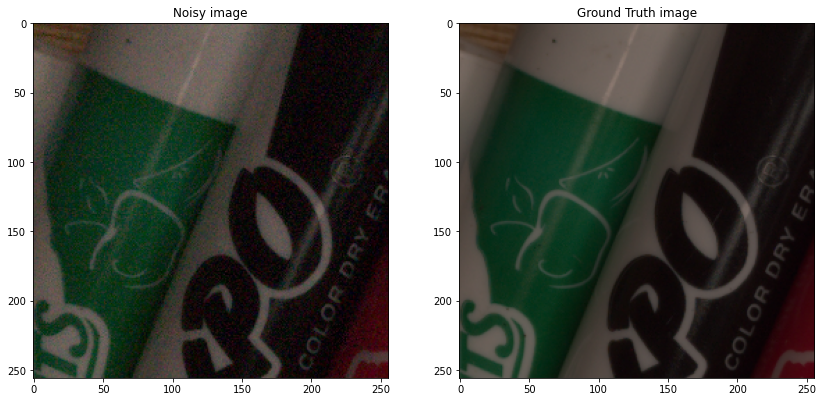

In [14]:
f, axarr = plt.subplots(1,2, figsize=(14,14))
axarr[0].imshow(noisy_train_images[5])
axarr[0].set_title("Noisy image")
axarr[1].imshow(gt_train_images[5])
axarr[1].title.set_text("Ground Truth image")

In [15]:
def _up_down_flip(image, label):
    image = tf.image.flip_up_down(image)
    label = tf.image.flip_up_down(label)
    return image, label

def _left_right_flip(image, label):
    image = tf.image.flip_left_right(image)
    label = tf.image.flip_left_right(label)
    return image, label

def _rotate(image, label):
    random_angle = tf.random.uniform(shape=[], minval=0, maxval=4, dtype=tf.int32)
    image = tf.image.rot90(image, random_angle)
    label = tf.image.rot90(label, random_angle)
    return image, label

def _hue(image, label):
    rand_value = random.uniform(-1,1)
    image = tf.image.adjust_hue(image, rand_value)
    label = tf.image.adjust_hue(label, rand_value)
    return image, label

def _brightness(image, label):
    rand_value = random.uniform(-0.08,0.25)
    image = tf.image.adjust_brightness(image, rand_value)
    label = tf.image.adjust_brightness(label, rand_value)
    return image, label

def _saturation(image, label):
    rand_value = random.uniform(1, 5)
    image = tf.image.adjust_saturation(image, rand_value)
    label = tf.image.adjust_saturation(label, rand_value)
    return image, label

def _contrast(image, label):
    rand_value = random.uniform(1, 3)
    image = tf.image.adjust_contrast(image, rand_value)
    label = tf.image.adjust_contrast(label, rand_value)
    return image, label

# What does batch, repeat, and shuffle do with TensorFlow Dataset?
# https://stackoverflow.com/q/53514495/7697658
def tf_data_generator(X, y, batch_size=32, augmentations=None):
    dataset = tf.data.Dataset.from_tensor_slices((X, y)) # This is the main step for data generation
    dataset = dataset.shuffle(1000, reshuffle_each_iteration=True)

    if augmentations:
        for f in augmentations:
            if np.random.uniform(0,1)<0.5:
                dataset = dataset.map(f, num_parallel_calls=2)

    dataset = dataset.repeat()
    dataset = dataset.batch(batch_size=batch_size, drop_remainder=True)
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
    return dataset

BATCH_SIZE=4
augmentation_lst = [_up_down_flip, _left_right_flip, _rotate]
image_generator_train = tf_data_generator(X=noisy_train_images, y=gt_train_images, batch_size=BATCH_SIZE, augmentations=augmentation_lst)
image_generator_test = tf_data_generator(X=noisy_test_images, y=gt_test_images, batch_size=BATCH_SIZE)

In [16]:
image_generator_train

<PrefetchDataset shapes: ((4, 256, 256, 3), (4, 256, 256, 3)), types: (tf.uint8, tf.uint8)>

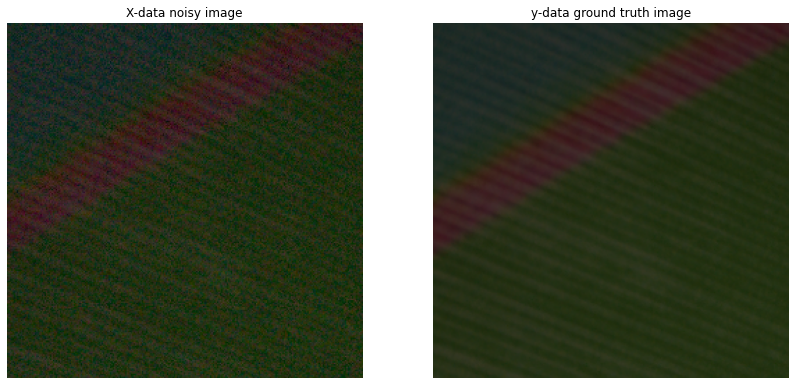

In [17]:
# SANITY CHECK of the Dataset generator
for noisy, gt in image_generator_train.take(1):  # only take first element of dataset
    numpy_images = noisy.numpy()
    numpy_labels = gt.numpy()

f, axarr = plt.subplots(1,2, figsize=(14,14))
axarr[0].imshow(numpy_images[1])
axarr[0].set_title("X-data noisy image")
axarr[0].set_axis_off()

axarr[1].imshow(numpy_labels[1])
axarr[1].set_title("y-data ground truth image")
axarr[1].set_axis_off()

# **MWCNN**

In [18]:
import tensorflow as tf
from tensorflow.keras import models, layers
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose,\
                                    GlobalAveragePooling2D, AveragePooling2D, MaxPool2D, UpSampling2D,\
                                    BatchNormalization, Activation, ReLU, Flatten, Dense, Input,\
                                    Add, Multiply, Concatenate, Softmax
from tensorflow.keras import initializers, regularizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.activations import softmax

tf.keras.backend.set_image_data_format('channels_last')
import keras.backend as K

Using TensorFlow backend.


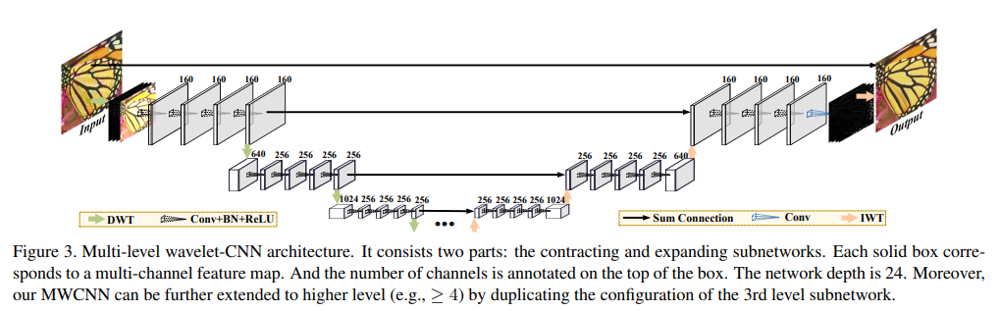

In [19]:
class Conv_block(tf.keras.layers.Layer):
    def  __init__(self, num_filters=200, kernel_size=3, **kwargs):
        super().__init__(**kwargs)
        self.num_filters=num_filters
        self.kernel_size=kernel_size
        self.conv_1 = Conv2D(filters=self.num_filters, kernel_size=self.kernel_size, padding='same')
        self.conv_2 = Conv2D(filters=self.num_filters, kernel_size=self.kernel_size, padding='same')
        self.conv_3 = Conv2D(filters=self.num_filters, kernel_size=self.kernel_size, padding='same')
        self.conv_4 = Conv2D(filters=self.num_filters, kernel_size=self.kernel_size, padding='same')

        self.bn_1 = BatchNormalization()
        self.bn_2 = BatchNormalization()
        self.bn_3 = BatchNormalization()
        self.bn_4 = BatchNormalization()
    
    def get_config(self):
        config = super().get_config().copy()
        config.update({
            'num_filters': self.num_filters,
            'kernel_size':self.kernel_size
        })
        return config

    def call(self, X):
        X = self.conv_1(X)
        # X = self.bn_1(X)
        X = ReLU()(X)
        X = self.conv_2(X)
        # X = self.bn_2(X)
        X = ReLU()(X)
        X = self.conv_3(X)
        # X = self.bn_3(X)
        X = ReLU()(X)
        # X = self.conv_4(X)
        # # X = self.bn_4(X)
        # X = ReLU()(X)

        return X

In [20]:
class DWT_downsampling(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        
    def call(self, x):

        x1 = x[:, 0::2, 0::2, :] #x(2i−1, 2j−1)
        x2 = x[:, 1::2, 0::2, :] #x(2i, 2j-1)
        x3 = x[:, 0::2, 1::2, :] #x(2i−1, 2j)
        x4 = x[:, 1::2, 1::2, :] #x(2i, 2j)   

        x_LL = x1 + x2 + x3 + x4
        x_LH = -x1 - x3 + x2 + x4
        x_HL = -x1 + x3 - x2 + x4
        x_HH = x1 - x3 - x2 + x4

        return Concatenate(axis=-1)([x_LL, x_LH, x_HL, x_HH])

In [21]:
class IWT_upsampling(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        
    def call(self, x):

        x_LL = x[:, :, :, 0:x.shape[3]//4]
        x_LH = x[:, :, :, x.shape[3]//4:x.shape[3]//4*2]
        x_HL = x[:, :, :, x.shape[3]//4*2:x.shape[3]//4*3]
        x_HH = x[:, :, :, x.shape[3]//4*3:]

        x1 = (x_LL - x_LH - x_HL + x_HH)/4
        x2 = (x_LL - x_LH + x_HL - x_HH)/4
        x3 = (x_LL + x_LH - x_HL - x_HH)/4
        x4 = (x_LL + x_LH + x_HL + x_HH)/4 

        y1 = K.stack([x1,x3], axis=2)
        y2 = K.stack([x2,x4], axis=2)
        shape = K.shape(x)
        return K.reshape(K.concatenate([y1,y2], axis=-1), K.stack([shape[0], shape[1]*2, shape[2]*2, shape[3]//4]))

In [22]:
# def create_model():
#     tf.keras.backend.clear_session()

#     input = Input(shape=(256,256,3))

#     cb_1 = Conv_block(num_filters=64)(input)
#     # print("cb 1=",cb_1.shape)
#     dwt_1 = DWT_downsampling()(cb_1)
#     # print("dwt 1=",dwt_1.shape)

#     cb_2 = Conv_block(num_filters=128)(dwt_1)
#     # print("cb 2=",cb_2.shape)
#     dwt_2 = DWT_downsampling()(cb_2)
#     # print("dwt 2=",dwt_2.shape)

#     cb_3 = Conv_block(num_filters=256)(dwt_2)
#     cb_4 = Conv_block(num_filters=256)(cb_3)
#     cb_4 = Conv2D(filters=512, kernel_size=3, strides=1, padding='same')(cb_4)

#     iwt_1 = IWT_upsampling()(cb_4)
#     cb_5 = Conv_block(num_filters=128)(Add()([iwt_1, cb_2]))
#     cb_5 = Conv2D(filters=256, kernel_size=3, strides=1, padding='same')(cb_5)

#     iwt_2 = IWT_upsampling()(cb_5)
#     cb_6 = Conv_block(num_filters=64)(Add()([iwt_2, cb_1]))
#     cb_6 = Conv2D(filters=3, kernel_size=(1, 1), padding="same")(cb_6)

#     out = cb_6

#     return Model(inputs=[input], outputs=[out])

In [23]:
def create_model():
    tf.keras.backend.clear_session()

    input = Input(shape=(256,256,3))

    cb_1 = Conv_block(num_filters=64)(input)
    dwt_1 = DWT_downsampling()(cb_1)

    cb_2 = Conv_block(num_filters=128)(dwt_1)
    dwt_2 = DWT_downsampling()(cb_2)

    cb_3 = Conv_block(num_filters=256)(dwt_2)
    dwt_3 = DWT_downsampling()(cb_3)

    cb_4 = Conv_block(num_filters=512)(dwt_3)
    dwt_4 = DWT_downsampling()(cb_4)

    cb_5 = Conv_block(num_filters=512)(dwt_4)
    cb_5 = BatchNormalization()(cb_5)
    cb_5 = Conv_block(num_filters=512)(cb_5)
    cb_5 = Conv2D(filters=2048, kernel_size=3, strides=1, padding='same')(cb_5)

    up = IWT_upsampling()(cb_5)
    up = Conv_block(num_filters=512)(Add()([up, cb_4]))
    up = Conv2D(filters=1024, kernel_size=3, strides=1, padding='same')(up)

    up = IWT_upsampling()(up)
    up = Conv_block(num_filters=256)(Add()([up, cb_3]))
    up = Conv2D(filters=512, kernel_size=3, strides=1, padding='same')(up)
    
    up = IWT_upsampling()(up)
    up = Conv_block(num_filters=128)(Add()([up, cb_2]))
    up = Conv2D(filters=256, kernel_size=3, strides=1, padding='same')(up)
    
    up = IWT_upsampling()(up)
    up = Conv_block(num_filters=64)(Add()([up, cb_1]))
    up = Conv2D(filters=128, kernel_size=3, strides=1, padding='same')(up)

    out = Conv2D(filters=3, kernel_size=(1, 1), padding="same")(up)

    return Model(inputs=[input], outputs=[out])

model = create_model()
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv_block (Conv_block)         (None, 256, 256, 64) 75648       input_1[0][0]                    
__________________________________________________________________________________________________
dwt_downsampling (DWT_downsampl (None, 128, 128, 256 0           conv_block[0][0]                 
__________________________________________________________________________________________________
conv_block_1 (Conv_block)       (None, 128, 128, 128 590208      dwt_downsampling[0][0]           
______________________________________________________________________________________________

# **Training**

In [24]:
steps_per_epoch_train = len(noisy_train_images)
steps_per_epoch_validation = len(noisy_test_images)

In [25]:
callbacks_lst = [
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', min_lr=0.0000009, min_delta=0.0001, factor=0.70, patience=3, verbose=1, mode='min'),
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, min_delta=0.0001, patience=10)
]

In [26]:
model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer=Adam(learning_rate=0.0009))
model.fit(image_generator_train, 
          validation_data=image_generator_test,
                        steps_per_epoch=steps_per_epoch_train,
                        validation_steps=steps_per_epoch_validation,
                        epochs=100,
                        verbose=1,
                        callbacks=callbacks_lst)

Epoch 1/100
38/38 [==============================] - 40s 748ms/step - loss: 66972.6484 - val_loss: 358.0113
Epoch 2/100
38/38 [==============================] - 28s 734ms/step - loss: 3160.0947 - val_loss: 276.2766
Epoch 3/100
38/38 [==============================] - 29s 775ms/step - loss: 173.4637 - val_loss: 237.5314
Epoch 4/100
38/38 [==============================] - 28s 751ms/step - loss: 153.1132 - val_loss: 215.3919
Epoch 5/100
38/38 [==============================] - 27s 708ms/step - loss: 138.1511 - val_loss: 177.8883
Epoch 6/100
38/38 [==============================] - 28s 729ms/step - loss: 86.9807 - val_loss: 105.2238
Epoch 7/100
38/38 [==============================] - 27s 724ms/step - loss: 54.8141 - val_loss: 77.8032
Epoch 8/100
38/38 [==============================] - 27s 717ms/step - loss: 47.7829 - val_loss: 69.2068
Epoch 9/100
38/38 [==============================] - 27s 713ms/step - loss: 44.8988 - val_loss: 62.3819
Epoch 10/100
38/38 [==============================

# **Inference**

gt_images are in range of 0-255 (int);<br>
noisy_images are in range of 0-255 (int);<br>
predicted_images are in range 0-255 (float);

In [39]:
# Inference
def inference_single_image(model, noisy_image):
    input_image = np.expand_dims(noisy_image, axis=0)
    predicted_image = model.predict(input_image)
    
    return predicted_image[0]

def inference_batch_images(model, noisy_images):
    predicted_image = model.predict(noisy_images)
    return predicted_image

In [40]:
def visualize_predictions(model, X_test, y_test, n):
    random_numbers = random.choices(range(X_test.shape[0]), k=n)    # Get n random indices
    for i in random_numbers:
        noisy_image = X_test[i]
        gt_image = y_test[i]
        predicted_image = inference_single_image(model, X_test[i])
        predicted_image/=255

        f, axarr = plt.subplots(1,3, figsize=(21,21))
        axarr[0].imshow(noisy_image)
        axarr[0].set_title("Noisy image")
        axarr[0].set_axis_off()
        axarr[1].imshow(gt_image)
        axarr[1].set_title("Ground truth image")
        axarr[1].set_axis_off()
        axarr[2].imshow(predicted_image)
        axarr[2].set_title("Predicted image")
        axarr[2].set_axis_off()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


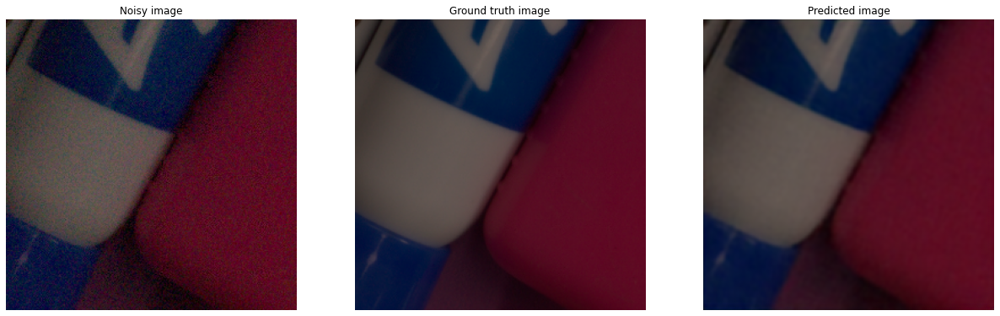

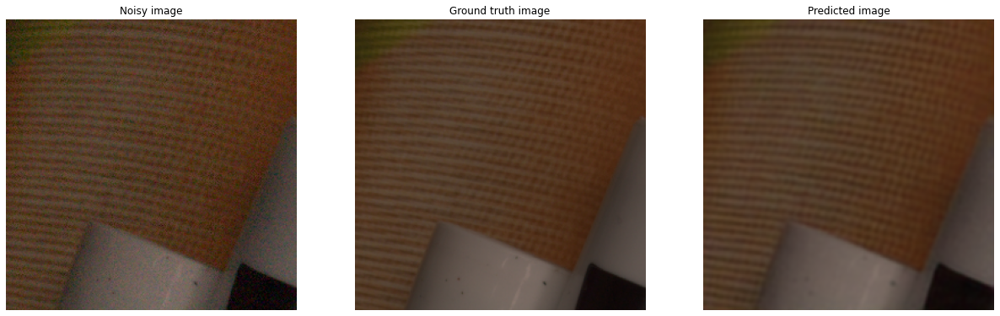

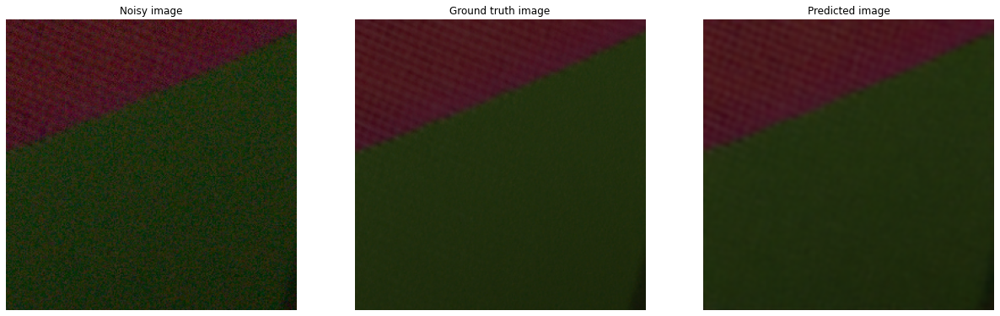

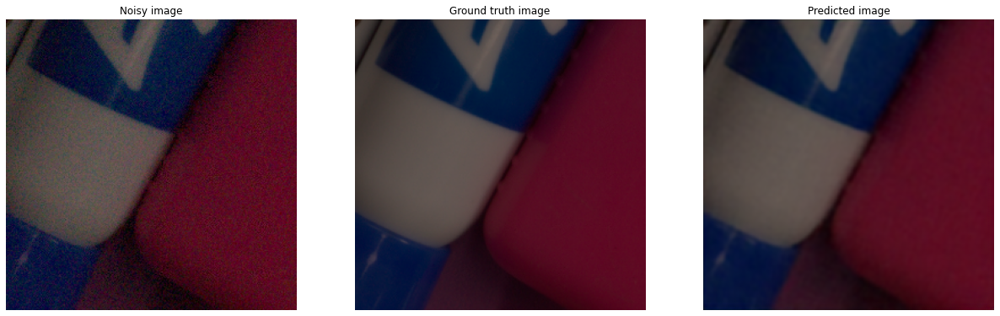

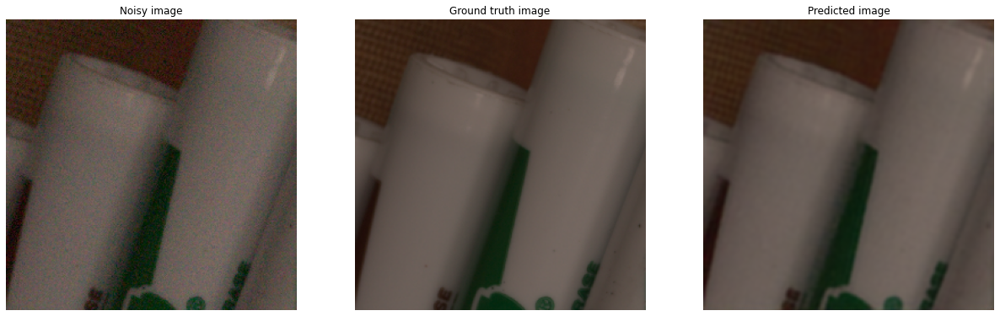

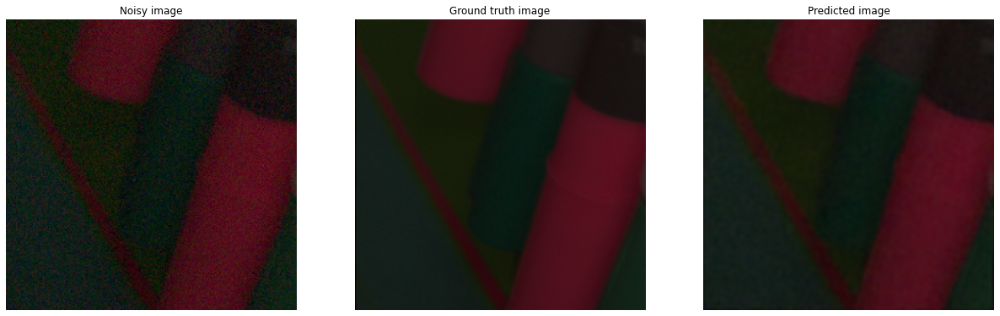

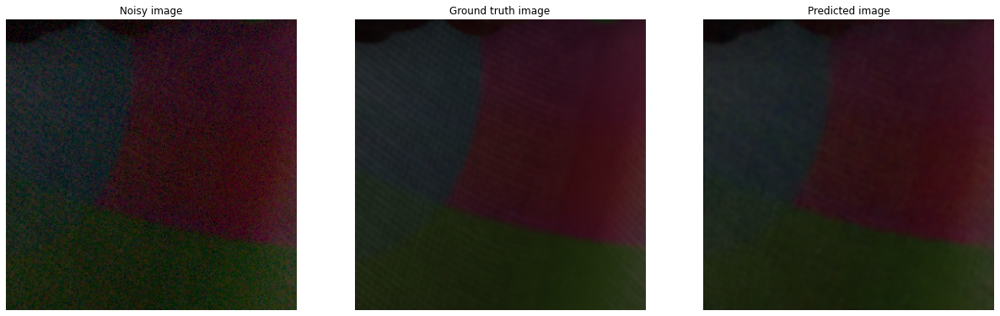

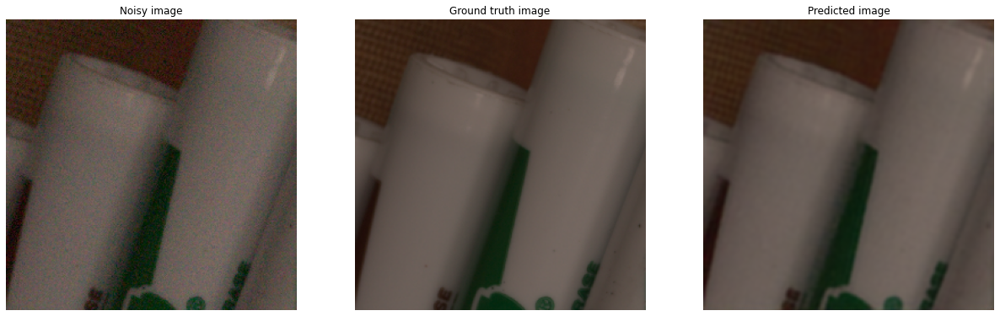

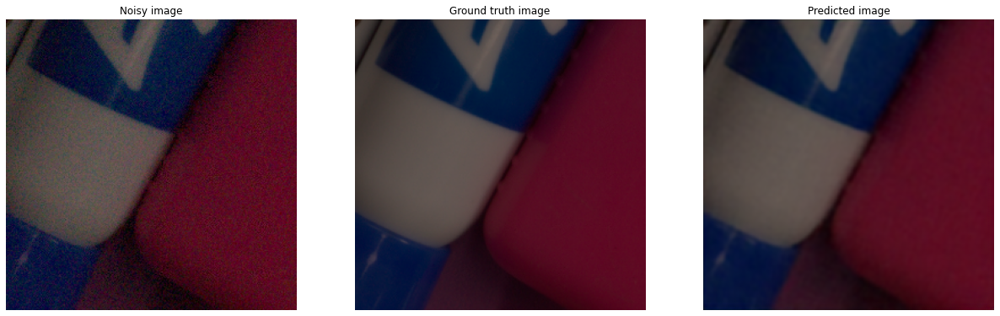

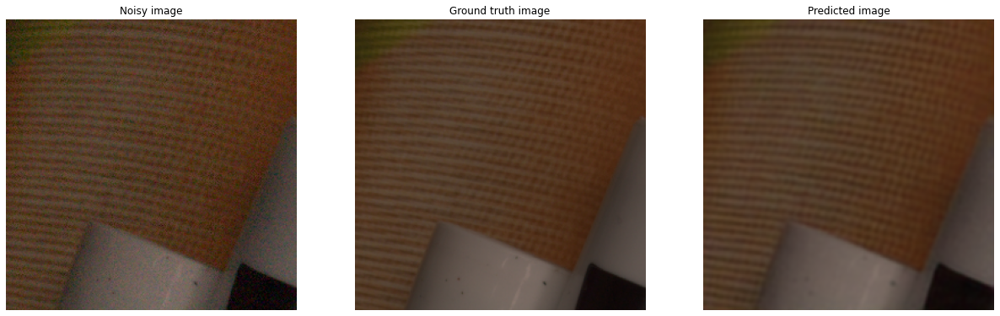

In [41]:
visualize_predictions(model, noisy_test_images, gt_test_images, 10)

In [57]:

root = pathlib.Path(r'E:\datasets\test\0114_005_IP_00100_00200_5500_N')
img_paths = list(root.rglob("*.PNG*"))
img_paths_lst = [str(path) for path in img_paths]
gt_lst = []
noisy_lst= []
for p in img_paths_lst:
    noisy_lst.append(p)

In [58]:
noisy_lst

['E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\1.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\10.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\11.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\12.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\13.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\14.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\15.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\16.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\17.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\18.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\19.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\2.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\20.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\21.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\22.PNG',
 'E:\\datasets\\test\\0114_005_IP_00100_00200_5500_N\\23.

In [59]:
file_list = os.listdir(root)

E:\datasets\test\0114_005_IP_00100_00200_5500_N\1.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\10.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\11.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\12.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\13.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\14.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\15.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\16.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\17.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\18.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\19.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\2.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\20.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\21.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\22.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\23.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\24.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\25.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\26.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\27.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\28.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\29.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\3.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\30.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\31.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\32.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\33.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\34.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\35.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\36.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\37.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\38.PNG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


E:\datasets\test\0114_005_IP_00100_00200_5500_N\39.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\4.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\40.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\41.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\42.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\43.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\44.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\45.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\46.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\47.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\48.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\5.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\6.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\7.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\8.PNG
E:\datasets\test\0114_005_IP_00100_00200_5500_N\9.PNG


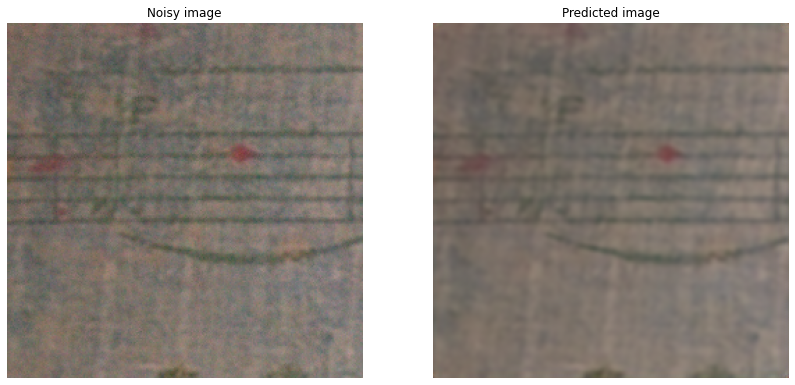

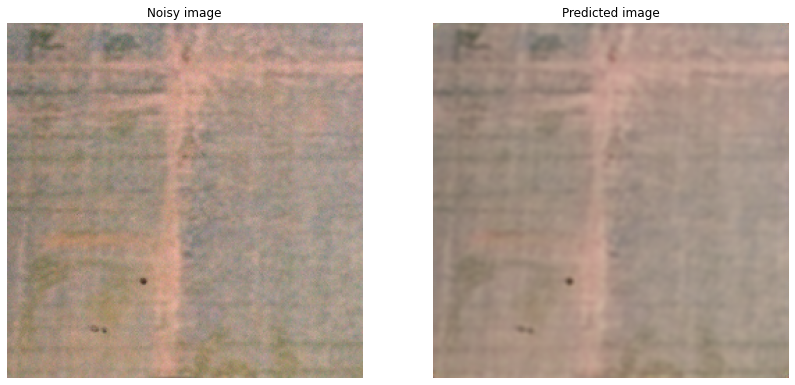

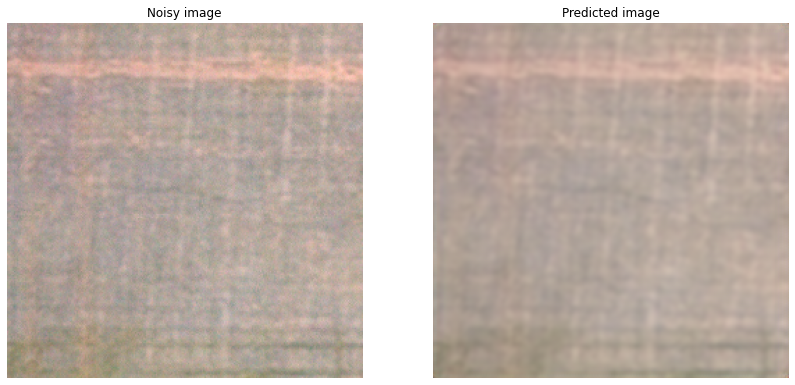

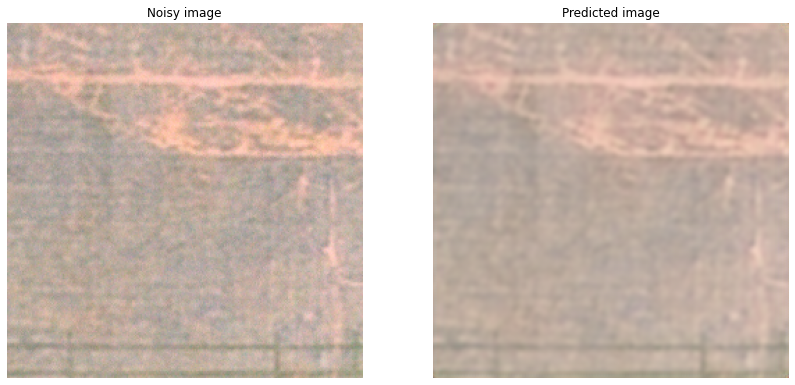

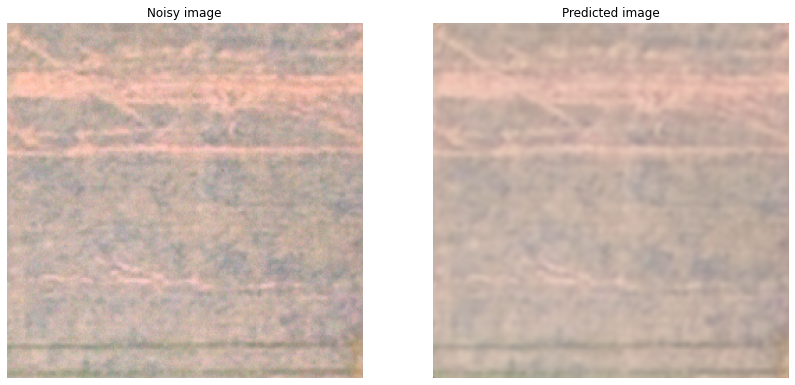

...

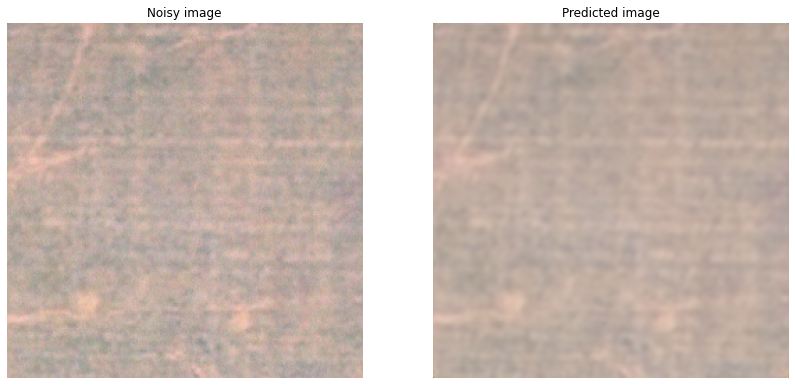

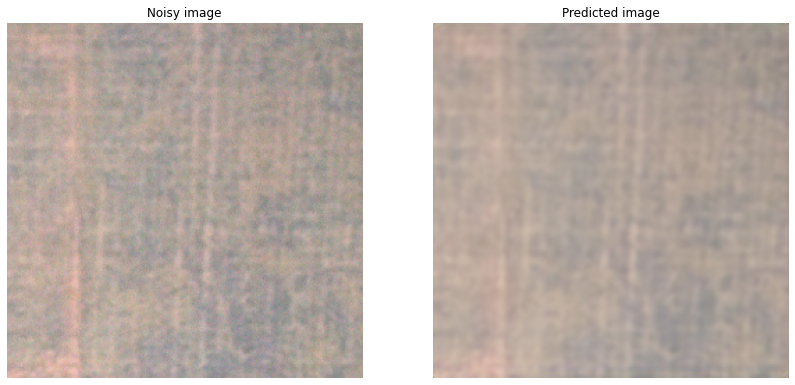

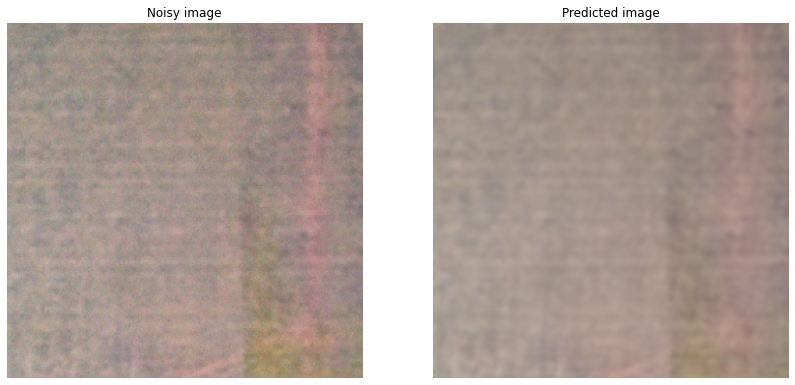

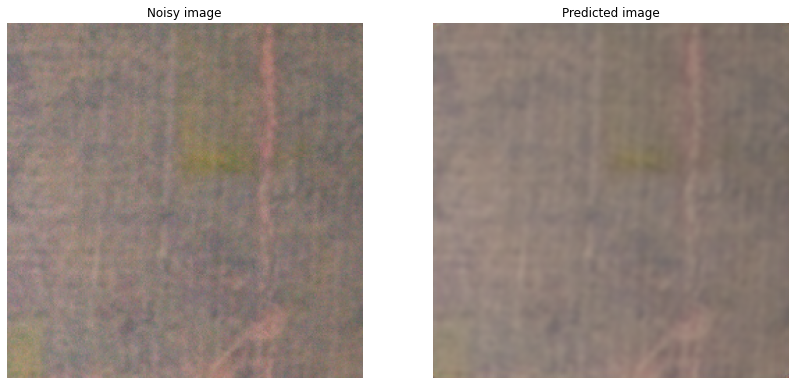

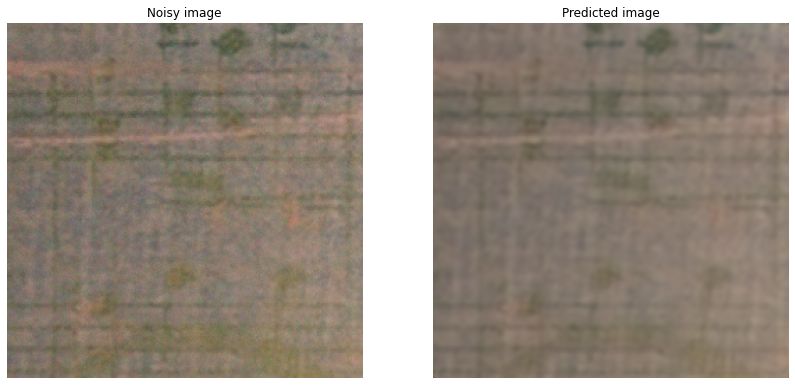

In [60]:
n=0
save_out = "E:/datasets/predict/0114_005_IP_00100_00200_5500_N/"
for i in noisy_lst:
    print(i)
    img = cv2.imread(i)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (256, 256))
    predicted_image = inference_single_image(model, img)
    predicted_image/=255
    f, axarr = plt.subplots(1,2, figsize=(14,14))
    axarr[0].imshow(img)
    axarr[0].title.set_text("Noisy image")
    axarr[0].set_axis_off()
    
    axarr[1].imshow(predicted_image)
    axarr[1].title.set_text("Predicted image")
    axarr[1].set_axis_off()

    j=file_list[n]
    out_name = j.split('.')[0]
    
    save_path = save_out + out_name + '.png'
    predicted_image=predicted_image*255
    cv2.imwrite(save_path,cv2.cvtColor(predicted_image, cv2.COLOR_RGB2BGR) )
    n=n+1


In [53]:
from skimage.metrics import peak_signal_noise_ratio

predicted_images = inference_batch_images(model, noisy_test_images)
psnr_original_mean = 0
psnr_prediction_mean = 0

for gt_img, noisy_img, predicted_img in zip(gt_test_images, noisy_test_images, predicted_images):
    psnr_original_mean += peak_signal_noise_ratio(gt_img, noisy_img)
    psnr_prediction_mean += peak_signal_noise_ratio(gt_img, predicted_img)

psnr_original_mean/=gt_test_images.shape[0]
psnr_prediction_mean/=gt_test_images.shape[0]
print("Original average gt-noisy PSNR ->", psnr_original_mean)
print("Predicted average gt-predicted PSNR ->", psnr_prediction_mean)

Original average gt-noisy PSNR -> 29.38856480052265
Predicted average gt-predicted PSNR -> 40.89787581720665


In [54]:
from skimage.metrics import structural_similarity as ssim

predicted_images = inference_batch_images(model, noisy_test_images)
ssim_original_mean = 0
ssim_prediction_mean = 0

for gt_img, noisy_img, predicted_img in zip(gt_test_images, noisy_test_images, predicted_images):
    ssim_original_mean += ssim(gt_img, noisy_img, multichannel=True, data_range=noisy_img.max() - noisy_img.min())
    ssim_prediction_mean += ssim(gt_img, predicted_img, multichannel=True, data_range=predicted_img.max() - predicted_img.min())

ssim_original_mean/=gt_test_images.shape[0]
ssim_prediction_mean/=gt_test_images.shape[0]
print("Original average gt-noisy SSIM ->", ssim_original_mean)
print("Predicted average gt-predicted SSIM ->", ssim_prediction_mean)

Original average gt-noisy SSIM -> 0.35881056817010415
Predicted average gt-predicted SSIM -> 0.8475921111362217
